# README

In [2]:
README = '''
Julian Smoller ~ 2017

The purpose of this project is to draw a map of Citibike stations in NYC. 

Note: I worked on this project in 2015. I created a website that shows a map of Citibike stations, 
and that site is still up and running in 2017. Now I am cobbling together different 
code into this one notebook so that I can document / remember my work
and upload it to git. 

General functions
The code below starts with two useful functions: (1) show image and (2) get n points. 
The function to show an image just renders an image in a relatively small amount of 
space, so that I can view large images within this notebool. 
The function to get n points take a number range -- e.g. from min 1 to max 3 -- 
and returns n evenly spaced points within that range, excluding the min and max.
I use this function to determine the central coordinates of the small maps
that I download within a given geographic longitude and latitude area. 

Citibike + Google APIs
The next section of code experiments with the Citibike API to get Citibike data,
and the Google API to download static map images. First I just test these functions 
in isolation before I encapsulate them within a map-maker class. 

Mapper
Finally, there is the MapMaker class. A MapMaker (MM) is initialized with the geographic 
coordinates -- longitude and latitude -- for the boundaries of the region that it will map. 


'''
print(README)


Julian Smoller ~ 2017

The purpose of this project is to draw a map of Citibike stations in NYC. 

Note: I worked on this project in 2015. I created a website that shows a map of Citibike stations, 
and that site is still up and running in 2017. Now I am cobbling together different 
code into this one notebook so that I can document / remember my work
and upload it to git. 

General functions
The code below starts with two useful functions: (1) show image and (2) get n points. 
The function to show an image just renders an image in a relatively small amount of 
space, so that I can view large images within this notebool. 
The function to get n points take a number range -- e.g. from min 1 to max 3 -- 
and returns n evenly spaced points within that range, excluding the min and max.
I use this function to determine the central coordinates of the small maps
that I download within a given geographic longitude and latitude area. 

Citibike + Google APIs
The next section of code experiments

# Import libraries + change display settings

In [22]:
import urllib.request
import urllib
import math
import pandas as pd
import numpy as np
from PIL import Image
from matplotlib.pyplot import imshow
import time
import pickle
% matplotlib inline

# Some general, useful functions

In [4]:
def show(im):
    return imshow(np.asarray(im))
def get_n_points(minimum=0,maximum=3,n=4):
    '''Generate a list of points (numbers) evenly distributed between min and max
    (excluding min and max)'''
    the_range = maximum - minimum
    the_increment = float(the_range)/n
    first_point = minimum + float(the_increment)/2
    points = []
    this_point = first_point
    for i in range(n):
        points.append(this_point)
        this_point += the_increment
    return points
get_n_points()

[0.375, 1.125, 1.875, 2.625]

# Get Citibike data

In [5]:
url = 'https://www.citibikenyc.com/stations/json'
response = urllib.request.urlopen(url)
data = response.read()

In [6]:
data[:1000]

b'{"executionTime":"2017-06-09 09:40:07 AM","stationBeanList":[{"id":72,"stationName":"W 52 St & 11 Ave","availableDocks":39,"totalDocks":39,"latitude":40.76727216,"longitude":-73.99392888,"statusValue":"In Service","statusKey":1,"availableBikes":0,"stAddress1":"W 52 St & 11 Ave","stAddress2":"","city":"","postalCode":"","location":"","altitude":"","testStation":false,"lastCommunicationTime":"2017-06-09 09:37:03 AM","landMark":""},{"id":79,"stationName":"Franklin St & W Broadway","availableDocks":18,"totalDocks":33,"latitude":40.71911552,"longitude":-74.00666661,"statusValue":"In Service","statusKey":1,"availableBikes":12,"stAddress1":"Franklin St & W Broadway","stAddress2":"","city":"","postalCode":"","location":"","altitude":"","testStation":false,"lastCommunicationTime":"2017-06-09 09:40:05 AM","landMark":""},{"id":82,"stationName":"St James Pl & Pearl St","availableDocks":12,"totalDocks":27,"latitude":40.71117416,"longitude":-74.00016545,"statusValue":"In Service","statusKey":1,"av

# Get Google maps

In [7]:
def make_url_for_google_maps(lon,lat):
    '''Generate a url that can be used to ask the Google maps API
    for a static map centered at given longitude and latitude'''
    url = "https://maps.googleapis.com/maps/api/staticmap?" 
    url += "center=" + str(lat) + ',' + str(lon)
    url += "&zoom=16&size=1000x1000&maptype=roadmap"
    return url

# Let's see what the URL looks like for a map centered at a specific location
lat_example, lon_example = (40.744419, -74.001684) # my apartment in New York
url = make_url_for_google_maps(lon_example,lat_example)
print(url)

https://maps.googleapis.com/maps/api/staticmap?center=40.744419,-74.001684&zoom=16&size=1000x1000&maptype=roadmap


In [8]:
def download_map(lon,lat,path):
    url = make_url_for_google_maps(lon,lat)
    urllib.request.urlretrieve(url,path)

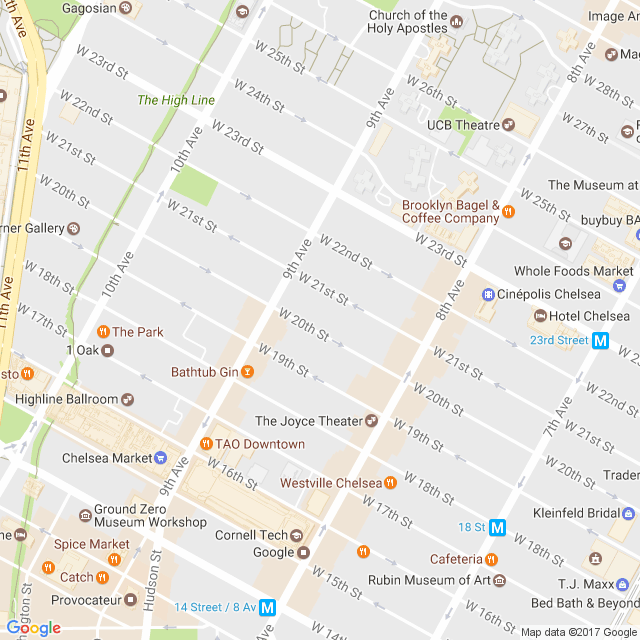

In [9]:
lat_example, lon_example = (40.744419, -74.001684) # my apartment in New York
path = 'data/output/example.jpg'
download_map(lon_example,lat_example,path)
Image.open(path)

# Create MapMaker

In [10]:
class MapMaker:
    '''A MapMaker can download and concatenate small maps to form a big 
    map of a given geographic region.'''
    def __init__(self, d):
        # Copy over exogenous variables
        self.lon0 = d['lon_left']
        self.lon1 = d['lon_right']
        self.lat0 = d['lat_bottom']
        self.lat1 = d['lat_top']
        self.x_pixels_per_image = d['x_pixels_per_image']
        self.y_pixels_per_image = d['y_pixels_per_image']
        self.x_pixels_per_longitude = d['x_pixels_per_longitude']
        self.y_pixels_per_latitude = d['y_pixels_per_latitude']
    def calculate_coordinates(self):
        # Calculate endogenous variables
        self.lon_per_image = self.x_pixels_per_image / self.x_pixels_per_longitude
        self.lat_per_image = self.y_pixels_per_image / self.y_pixels_per_latitude
        self.n_images_x = int(math.ceil(abs(self.lon1-self.lon0)/self.lon_per_image))
        self.n_images_y = int(math.ceil(abs(self.lat1-self.lat0)/self.lat_per_image))
        self.n_pixels_x = int(math.ceil(abs(self.lon1-self.lon0)*self.x_pixels_per_longitude))
        self.n_pixels_y = int(math.ceil(abs(self.lat1-self.lat0)*self.y_pixels_per_latitude))
        # Calculate small map coordinates
        self.small_map_longitudes = get_n_points(minimum=self.lon0,maximum=self.lon1,n=self.n_images_x)
        self.small_map_latitudes = get_n_points(minimum=self.lat0,maximum=self.lat1,n=self.n_images_y)
        self.small_maps = [(lon,lat) for lon in self.small_map_longitudes for lat in self.small_map_latitudes]
        self.small_maps = pd.DataFrame(self.small_maps, columns=['lon','lat'])
        self.small_maps['x_center'] = self.small_maps['lon'].map(lambda i: self.lon_to_x(i))
        self.small_maps['y_center'] = self.small_maps['lat'].map(lambda i: self.lat_to_y(i))
        # Calculate upper left corner of each small map image, in xy pixels
        x_offset = int(self.x_pixels_per_image/2)
        y_offset = int(self.y_pixels_per_image/2)
        self.small_maps['x_top_left'] = self.small_maps['x_center'].map(lambda x: x-x_offset)
        self.small_maps['y_top_left'] = self.small_maps['y_center'].map(lambda y: y-y_offset)
    def download_map(self,lon,lat,path):
        url = make_url_for_google_maps(lon,lat)
        urllib.URLopener().retrieve(url,path)
    def lon_to_x(self, lon):
        return int((lon-self.lon0)*self.x_pixels_per_longitude)
    def lat_to_y(self, lat):
        return self.n_pixels_y - int((lat-self.lat0)*self.y_pixels_per_latitude)
    def prepare_to_download(self,path='data/output/small_maps/'):
        # Prepare to download
        n_digits = len(str(len(self.small_maps))) # Number of digits required to number small maps, e.g. 3 for 108
        self.small_maps['file_name'] = self.small_maps.index.map(lambda i: 'map_'+str(i).zfill(n_digits)+'.jpg')
        self.small_maps['file_path']=self.small_maps['file_name'].map(lambda x: path+x)
        self.small_maps['download_status'] = 0
    def download_small_maps(self,n_max=300):
        '''Iterate through dataframe of small maps and request map from Google API'''
        for i in self.small_maps.index[:n_max]: # max number of maps
            print('Downloading small map '+str(i))
            if self.small_maps.ix[i,'download_status']==0:
                lon = self.small_maps.ix[i,'lon']
                lat = self.small_maps.ix[i,'lat']
                file_path = self.small_maps.ix[i,'file_path']
                download_map(lon,lat,file_path)
                self.small_maps.ix[i,'download_status']=1
                time.sleep(1)
    def create_big_map(self,path='data/output/big_map/big_map.jpg'):
        '''Concatenate small maps into big map, and save as image file at specified path'''
        big_map = Image.new('RGB', (self.n_pixels_x, self.n_pixels_y), (0,0,0))
        for i in self.small_maps.index:
            if self.small_maps.ix[i,'download_status']==1:
                print('Adding small map '+str(i))
                # Load small map from path
                small_map = Image.open(self.small_maps.ix[i,'file_path'])
                # Paste small image into big image
                x = self.small_maps.ix[i,'x_top_left']
                y = self.small_maps.ix[i,'y_top_left']
                big_map.paste(small_map, (x,y))
        big_map.save(path)
        return big_map

# Calculate coordinates

In [11]:
# Prepare a dictionary with exogenous variables for creating a mapper
map_info = {
    'lon_left':-74.036050,
    'lon_right': -73.924599,
    'lat_bottom': 40.678195,
    'lat_top': 40.802146,
    'x_pixels_per_image': 640, 
    'y_pixels_per_image': 640,
    'x_pixels_per_longitude': 46600.0, # Calculated through trial and error
    'y_pixels_per_latitude': 61500.0 # Calculated through trial and error
}
mm = MapMaker(map_info)
mm.calculate_coordinates()

In [12]:
# Once the mapper is initialized, it should have a conversion ratio (between pixels and degrees),
# and it should have a plan for how many images to download (e.g. 9x12) and how many pixels the
# final map will be (e.g. 5194x7623)
print((mm.lon_per_image, mm.lat_per_image, mm.n_images_x, mm.n_images_y, mm.n_pixels_x, mm.n_pixels_y))
# Tha mapper should also be able to convert longitude and latitude to x and y pixels
my_aprtment_in_new_york = (40.744419, -74.001684)
print(mm.lon_to_x(my_aprtment_in_new_york[1]),mm.lat_to_y(my_aprtment_in_new_york[0]))
# The mapper should have a plan for where it intends to position each small map
print(mm.small_map_longitudes)
print(mm.small_map_latitudes)
# The mapper should create a dataframe where it stores GPS info, etc. for each small map
print(len(mm.small_maps))
# Note:  negative values are OK! Some small maps get pasted off the canvas
mm.small_maps.head()

(0.013733905579399141, 0.01040650406504065, 9, 12, 5194, 7623)
1601 3551
[-74.02985827777778, -74.01747483333334, -74.0050913888889, -73.99270794444446, -73.98032450000002, -73.96794105555558, -73.95555761111115, -73.94317416666671, -73.93079072222227]
[40.683359625, 40.693688875, 40.704018125, 40.714347374999996, 40.724676624999994, 40.73500587499999, 40.74533512499999, 40.75566437499999, 40.765993624999986, 40.776322874999984, 40.78665212499998, 40.79698137499998]
108


,lon,lat,x_center,y_center,x_top_left,y_top_left
0,-74.029858,40.683360,288,7306,-32,6986
1,-74.029858,40.693689,288,6671,-32,6351
2,-74.029858,40.704018,288,6035,-32,5715
3,-74.029858,40.714347,288,5400,-32,5080
4,-74.029858,40.724677,288,4765,-32,4445


# Prepare to download

In [13]:
# Prepare to download small maps; add columns for file path and downlod status
mm.prepare_to_download()
mm.small_maps.head()

,lon,lat,x_center,y_center,x_top_left,y_top_left,file_name,file_path,download_status
0,-74.029858,40.683360,288,7306,-32,6986,map_000.jpg,data/output/small_maps/map_000.jpg,0
1,-74.029858,40.693689,288,6671,-32,6351,map_001.jpg,data/output/small_maps/map_001.jpg,0
2,-74.029858,40.704018,288,6035,-32,5715,map_002.jpg,data/output/small_maps/map_002.jpg,0
3,-74.029858,40.714347,288,5400,-32,5080,map_003.jpg,data/output/small_maps/map_003.jpg,0
4,-74.029858,40.724677,288,4765,-32,4445,map_004.jpg,data/output/small_maps/map_004.jpg,0


# Download small maps

In [14]:
# Test by downloading a few maps
mm.download_small_maps(n_max=5)

In [15]:
# The download status should now be 1 for the first few maps
mm.small_maps.head()

,lon,lat,x_center,y_center,x_top_left,y_top_left,file_name,file_path,download_status
0,-74.029858,40.683360,288,7306,-32,6986,map_000.jpg,data/output/small_maps/map_000.jpg,1
1,-74.029858,40.693689,288,6671,-32,6351,map_001.jpg,data/output/small_maps/map_001.jpg,1
2,-74.029858,40.704018,288,6035,-32,5715,map_002.jpg,data/output/small_maps/map_002.jpg,1
3,-74.029858,40.714347,288,5400,-32,5080,map_003.jpg,data/output/small_maps/map_003.jpg,1
4,-74.029858,40.724677,288,4765,-32,4445,map_004.jpg,data/output/small_maps/map_004.jpg,1


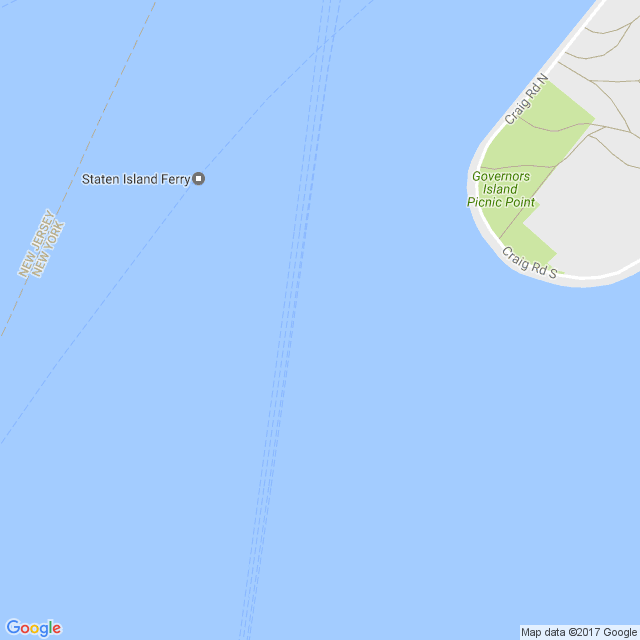

In [16]:
# Check to see if small map succesfully downloaded
Image.open('data/output/small_maps/map_000.jpg')

In [17]:
# Download all the small maps
mm.download_small_maps(n_max=200)

# Create big map

In [18]:
path='data/output/big_map/big_map.jpg'
big_map = mm.create_big_map(path=path)

Adding small map 0
Adding small map 1
Adding small map 2
Adding small map 3
Adding small map 4
Adding small map 5
Adding small map 6
Adding small map 7
Adding small map 8
Adding small map 9
Adding small map 10
Adding small map 11
Adding small map 12
Adding small map 13
Adding small map 14
Adding small map 15
Adding small map 16
Adding small map 17
Adding small map 18
Adding small map 19
Adding small map 20
Adding small map 21
Adding small map 22
Adding small map 23
Adding small map 24
Adding small map 25
Adding small map 26
Adding small map 27
Adding small map 28
Adding small map 29
Adding small map 30
Adding small map 31
Adding small map 32
Adding small map 33
Adding small map 34
Adding small map 35
Adding small map 36
Adding small map 37
Adding small map 38
Adding small map 39
Adding small map 40
Adding small map 41
Adding small map 42
Adding small map 43
Adding small map 44
Adding small map 45
Adding small map 46
Adding small map 47
Adding small map 48
Adding small map 49
Adding sma

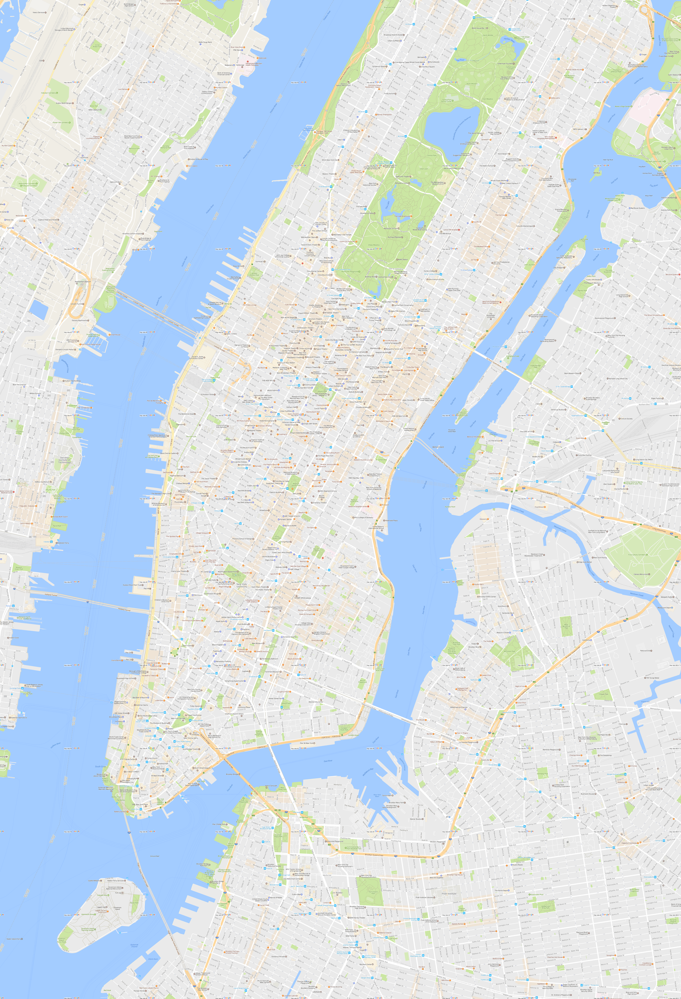

In [19]:
big_map

# Pickle the MapMaker

In [24]:
path = 'data/output/MapMaker.p'
pickle.dump(mm,open(path,'wb'))

In [25]:
# Load the MapMaker, just to check if it worked
mm2 = pickle.load(open(path,'rb'))
mm2.small_maps.head()

,lon,lat,x_center,y_center,x_top_left,y_top_left,file_name,file_path,download_status
0,-74.029858,40.683360,288,7306,-32,6986,map_000.jpg,data/output/small_maps/map_000.jpg,1
1,-74.029858,40.693689,288,6671,-32,6351,map_001.jpg,data/output/small_maps/map_001.jpg,1
2,-74.029858,40.704018,288,6035,-32,5715,map_002.jpg,data/output/small_maps/map_002.jpg,1
3,-74.029858,40.714347,288,5400,-32,5080,map_003.jpg,data/output/small_maps/map_003.jpg,1
4,-74.029858,40.724677,288,4765,-32,4445,map_004.jpg,data/output/small_maps/map_004.jpg,1
